In [1]:
from JupyterImport import *
from src.DataStandardize.ExpSpecific.Sep20 import Fixes
root_logger.setLevel(logging.WARNING)
import copy

In [17]:

dats = get_dats((6780, 6885+1))  # 100mK Along transition in 3x DAC steps
dats.extend(get_dats((6887, 6894+1)))  # Computer crashed, so carrying on from here

dats.extend(get_dats((7056, 7139+1)))  # WIth ramp square wave

for dat in dats:
    Fixes.fix_magy(dat)
    
dat_dict = {dat.datnum: dat for dat in dats}
p1_dats = dats[::2]
dat_pairs = [(dat, dat_dict[dat.datnum+1]) for dat in p1_dats]

100% (106 of 106) |######################| Elapsed Time: 0:00:24 Time:  0:00:24
100% (8 of 8) |##########################| Elapsed Time: 0:00:03 Time:  0:00:03
100% (84 of 84) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


## Set up default fitting parameters, and use this to fit all/weakly coupled data

In [18]:
analysis_params = EA.EA_params(bin_data=False, num_per_row=500,
                               sub_line=False, sub_line_range=(-4000, -600),
                               int_entropy_range=(300, 400),
                               allowed_amp_range=(0.6,1.601), default_amp=0.928,
                               allowed_dT_range=(0.001, 10.002), default_dT=1.1,
                               CT_fit_range=(-250, 250),
                               fit_param_edit_kwargs=dict(),
                               E_fit_range=(-200, 200), 
                               calculate_uncertainty=True, 
                               batch_uncertainty=10,
                               center_data=True)

In [19]:
recalculate = True

for pair in progressbar(dat_pairs):
    if recalculate or not hasattr(pair[0].Other, 'EA_values'):
        EA.standard_square_process(pair, analysis_params)

N/A% (0 of 99) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
  1% (1 of 99) |                         | Elapsed Time: 0:00:00 ETA:   0:00:52WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
  2% (2 of 99) |                         | Elapsed Time: 0:00:00 ETA:   0:00:39WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 53% (53 of 99) |############            | Elapsed Time: 0:00:21 ETA:   0:00:41WARNING:src.Scripts.SquareEntropyAnalysis:Indexs averaging integrated data were the same so defaulting to last 5% of data
 96% (96 of 99) |####################### | Elapsed Time: 0:00:36 ETA:   0:00:00WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 97% (97 of 99) |####################### | Elapsed Time: 0:00:36 ETA:   0:00:00WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 98% (98 of 99

## Fit Dats that are Gamma broadened using some fixed values determined from weakly coupled

Filter the dats to get only dats that are gamma broadened (or whatever the filter is)

In [23]:
filt_name = 'LCT'
filt_threshold = -375
filt_val = lambda pair: pair[0].Logs.fds['LCT']
filt_func = lambda pair: filt_val(pair) > filt_threshold

temp_pairs = [pair for pair in dat_pairs if filt_func(pair)]
temp_pairs = CU.order_list(temp_pairs, [filt_val(pair) for pair in temp_pairs])

Set up some new fixed parameters

In [24]:
gamma_analysis_params = copy.copy(analysis_params)
gamma_analysis_params.allowed_amp_range = (0,1.5)
gamma_analysis_params.default_amp = 0.5
gamma_analysis_params.allowed_dT_range = (1,1.01)
gamma_analysis_params.default_dT = 2.470

gamma_analysis_params.CT_fit_func = 'i_sense_digamma'
gamma_analysis_params.CT_fit_param_edit_kwargs = {'param_name': ['theta'], 'value': [21.064], 'vary': [False]}

In [25]:
recalculate = True

for pair in progressbar(temp_pairs):
    if recalculate or not hasattr(pair[0].Other, 'EA_values'):
        EA.standard_square_process(pair, gamma_analysis_params)


N/A% (0 of 43) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
  2% (1 of 43) |                         | Elapsed Time: 0:00:00 ETA:   0:00:14WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
  4% (2 of 43) |#                        | Elapsed Time: 0:00:00 ETA:   0:00:13WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 90% (39 of 43) |#####################   | Elapsed Time: 0:00:21 ETA:   0:00:04WARNING:src.Scripts.SquareEntropyAnalysis:Indexs averaging integrated data were the same so defaulting to last 5% of data
100% (43 of 43) |########################| Elapsed Time: 0:00:27 Time:  0:00:27


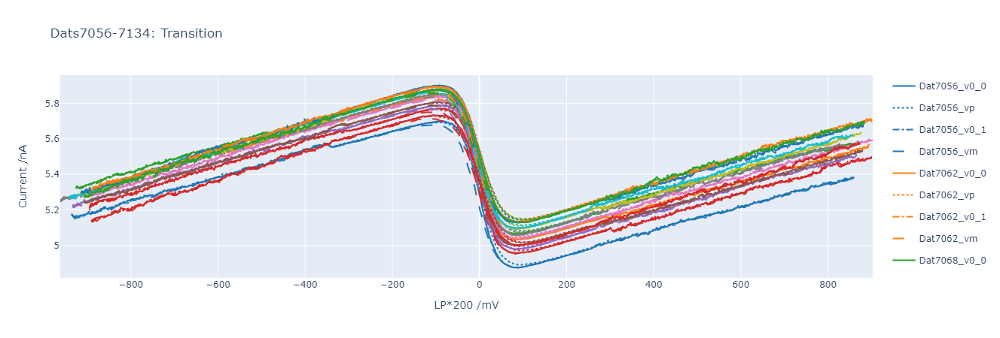

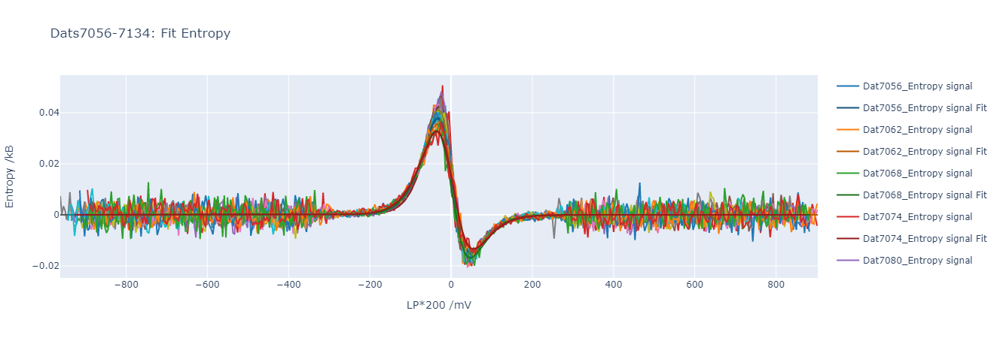

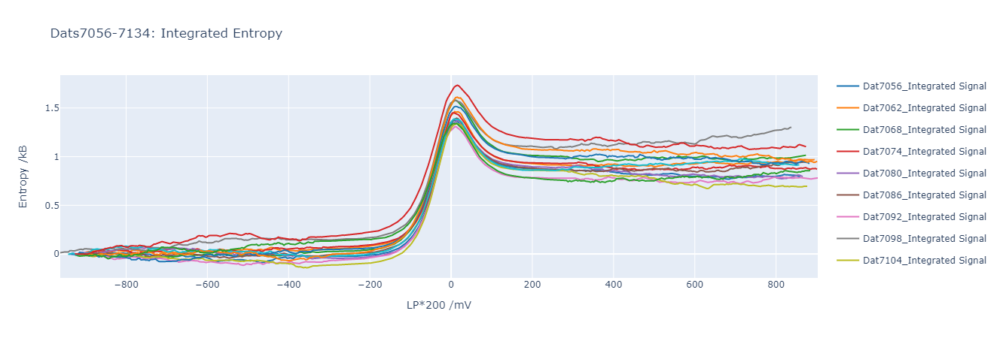

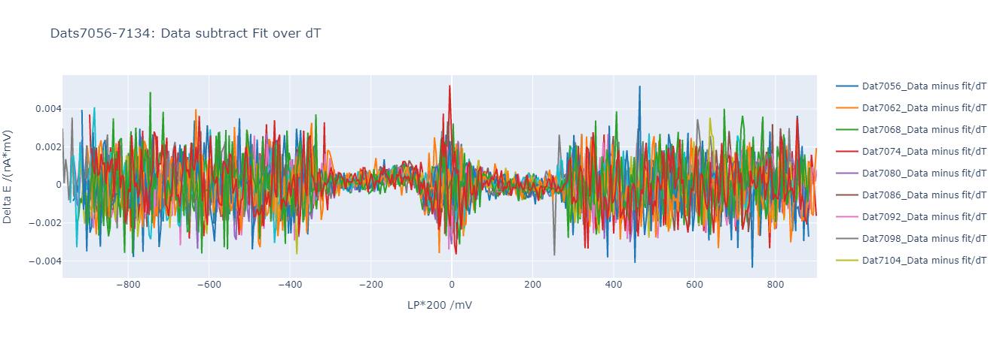

In [6]:
lims = (None, None)
dd = {dat.datnum: dat for dat in dats}
# start = 4893  #4881
start = 6146
single_dat = False
# ds = [dd[num] for num in [start, start+44, start+44*2]]  # 
a = 0
# ds = [dd[num] for num in [6219+a, 6275+a, 6331+a, 6517+a, 6182+a]]
# ds = [dd[num] for num in [6523, 6573, 6579, 6327]]
# ds = [dd[num] for num in np.arange(start, start+10, 2)]
ds = dats[::3]
# ds = [dd[num] for num in np.arange(start, start+37, 4)]  # RCB
# ds = [dd[num] for num in np.arange(start, start+281, 40)]  # field
# ds = [dd[num] for num in np.arange(start, start+41, 8)]  # hqpc

get_additional_data = [lambda dat: dat.Logs.fds['LCT'],
                       lambda dat: dat.AWG.AWs[0][0][1]/10,
                       lambda dat: dat.Other.EA_values.dT,
                       lambda dat: dat.Other.EA_values.dS,
                       lambda dat: dat.Other.EA_values.int_dS,
                       lambda dat: dat.Logs.fds['LCSS'],
                       lambda dat: dat.Logs.fds['LCB'],
                       lambda dat: dat.AWG.info.measureFreq/dat.AWG.info.wave_len]
additional_hover_template = '<br>'.join(('<extra>%{fullData.name}', 
                                         'LCT=%{customdata[1]:.1f}mV',
                                         'Bias=%{customdata[2]:.0f}nA',
                                         'dT=%{customdata[3]:.2f}mV',
                                         'dS=%{customdata[4]:.2f}kB',
                                         'int_dS=%{customdata[5]:.2f}kB',
                                         'LCSS=%{customdata[6]:.1f}mV',
                                         'LCB=%{customdata[7]:.1f}mV',
                                         'Freq=%{customdata[8]:.1f}Hz'
                                         '</extra>'))

figt = EA.Plots.waterfall(ds[lims[0]:lims[1]], which='transition', mode='lines', add_fits=False, shift_per=0.0, get_additional_data=get_additional_data, additional_hover_template=additional_hover_template, single_dat=single_dat)
fige = EA.Plots.waterfall(ds[lims[0]:lims[1]], which='entropy', mode='lines', add_fits=True, shift_per=0.00, get_additional_data=get_additional_data, additional_hover_template=additional_hover_template, single_dat=single_dat)
figi = EA.Plots.waterfall(ds[lims[0]:lims[1]], which='integrated', mode='lines', add_fits=False, shift_per=0.0, get_additional_data=get_additional_data, additional_hover_template=additional_hover_template, single_dat=single_dat)
figdmf = EA.Plots.waterfall(ds[lims[0]:lims[1]], which='data_minus_fit_scaled', mode='lines', add_fits=False, shift_per=0.00, get_additional_data=get_additional_data, additional_hover_template=additional_hover_template, single_dat=single_dat)
figs = (figt, fige, figi, figdmf)
for fig in figs:
    title = fig.layout.title.text
    field = ds[0].Logs.magy.field
    bias = ds[0].AWG.AWs[0][0][1]/10
#     fig.update_layout(title=title+f'<br>Field={field:.0f}mT, HQPC Bias={bias:.1f}nA')

for fig in figs:
    fig.show()

In [136]:
names = ('Transition', 'Entropy', 'Integrated Entropy', 'Data minus fit over dT')
save_graph=True
graphs_to_save = [0]
if save_graph:
    for i in graphs_to_save:
        figs[i].write_html(export_path+f'Dats{dats[0].datnum}-{dats[-1].datnum} -- Waterfall plot of {names[i]}.html')

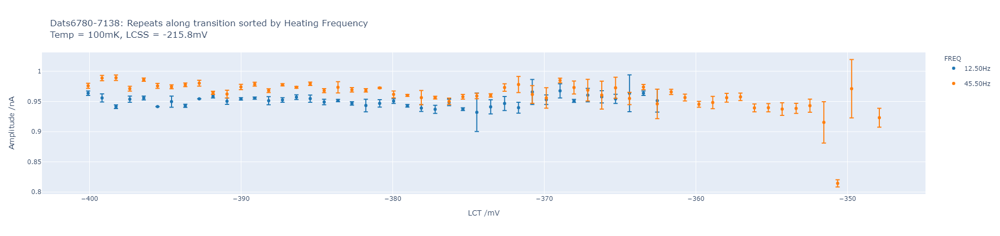

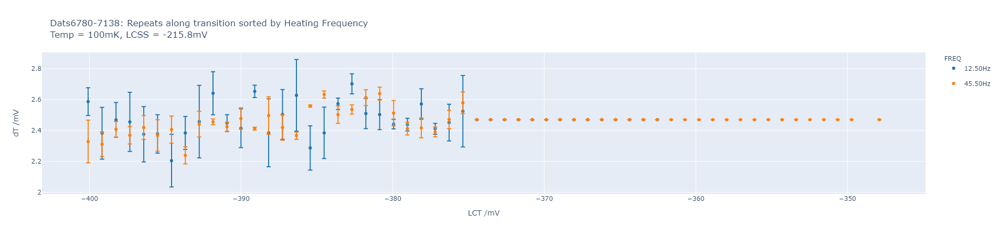

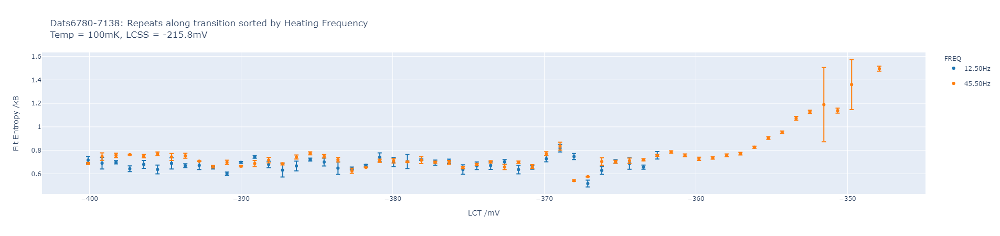

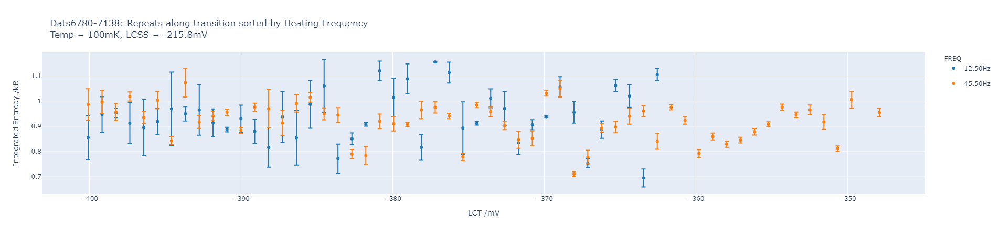

In [26]:
which_sorts = ['freq']*4
which_ys = ['amp', 'dt', 'fit_ds', 'int_ds']
which_xs = ['lct']*4
tols = [1]*4


get_additional_data = [lambda dat: dat.Logs.bds['RCB'],
                       lambda dat: dat.SquareEntropy.SquareAWG.AWs[0][0][1]/10,
                       lambda dat: dat.Other.EA_values.dT,
                       lambda dat: dat.Other.EA_values.amp,
                       lambda dat: dat.Other.EA_values.dS,
                       lambda dat: dat.Other.EA_values.int_dS,
                       lambda dat: dat.Logs.magy.field]
additional_hover_template = '<br>'.join(('<extra>%{fullData.name}', 
                                         'RCB=%{customdata[1]:.1f}mV',
                                         'Bias=%{customdata[2]:.0f}nA',
                                         'dT=%{customdata[3]:.2f}mV',
                                         'amp=%{customdata[4]:.2f}nA',
                                         'dS=%{customdata[5]:.2f}kB',
                                         'int_dS=%{customdata[6]:.2f}kB',
                                         'Field=%{customdata[7]:.0f}mT'
                                         '</extra>'))
figs = list()
for which_sort, which_y, which_x, tol in zip(which_sorts, which_ys, which_xs, tols):
    figs.append(EA.Plots.sorted(dats, which_sort=which_sort, which_x=which_x, which_y=which_y, sort_array=None, sort_tol=tol, uncertainties='bars', get_additional_data=get_additional_data, additional_hover_template=additional_hover_template))
    
for fig, ws in zip(figs, which_sorts):
    fig.update_layout(legend_title = ws.upper())
    fig.update_layout(title = fig.layout.title.text+f'<br>Temp = {dats[0].Logs.temps.mc*1000:.0f}mK, LCSS = {dats[0].Logs.fds["LCSS"]:.1f}mV')
    
for fig in figs:
    fig.show()

In [27]:
save_graph=True
graphs_to_save = [0, 1, 2, 3]
if save_graph:
    for i in graphs_to_save:
        figs[i].write_html(export_path+f'Dats{dats[0].datnum}-{dats[-1].datnum} -- Repeats along transition various {which_sorts[i]} -- {which_ys[i]} vs {which_xs[i]}.html')

## Calculate Average dT/amp from dats

In [21]:
filt_name = 'LCT'
filt_val = lambda dat: dat.Logs.fds['LCT']
filt_func = lambda dat: (filt_val(dat) < -375) and np.isclose(dat.AWG.freq, 12.5, atol=1)

temp_dats = [dat for dat in dats if filt_func(dat)]
temp_dats = CU.order_list(temp_dats, [filt_val(dat) for dat in temp_dats])

get_vals, names, units = list(), list(), list()

get_vals.append(lambda dat: dat.Other.EA_values.dT)
names.append('dT')
units.append('mV')

get_vals.append(lambda dat: dat.Other.EA_values.amp)
names.append('Amp')
units.append('nA')

get_vals.append(lambda dat: dat.Other.EA_values.tc)
names.append('Theta')
units.append('mV')



print(f'For dats{temp_dats[0].datnum}->{temp_dats[-1].datnum} ({filt_name}={filt_val(temp_dats[0]):.0f}->{filt_val(temp_dats[-1]):.0f}mV) avg:')
for get_val, name, unit in zip(get_vals, names, units):
    dts = [get_val(dat) for dat in temp_dats]
    print(f'\t {name} = {np.nanmean(dts):.3f}{unit}, stdev = {np.nanstd(dts):.3f}{unit}')

For dats7056->7111 (LCT=-400->-375mV) avg:
	 dT = 2.470mV, stdev = 0.111mV
	 Amp = 0.949nA, stdev = 0.007nA
	 Theta = 21.064mV, stdev = 0.357mV


In [ ]:
dat = get_dat(7031)
Fixes.fix_magy(dat)


In [28]:
for dat in dats:
    print(dat.datnum, dat.Other.EA_values.g)

6780 nan
6781 nan
6782 nan
6783 nan
6784 nan
6785 nan
6786 nan
6787 nan
6788 nan
6789 nan
6790 nan
6791 nan
6792 nan
6793 nan
6794 nan
6795 nan
6796 nan
6797 nan
6798 nan
6799 nan
6800 nan
6801 nan
6802 nan
6803 nan
6804 nan
6805 nan
6806 nan
6807 nan
6808 nan
6809 nan
6810 nan
6811 nan
6812 nan
6813 nan
6814 nan
6815 nan
6816 nan
6817 nan
6818 nan
6819 nan
6820 nan
6821 nan
6822 nan
6823 nan
6824 nan
6825 nan
6826 nan
6827 nan
6828 nan
6829 nan
6830 nan
6831 nan
6832 nan
6833 nan
6834 nan
6835 nan
6836 1.4350615135514353
6837 1.4350615135514353
6838 1.4494009926413156
6839 1.4494009926413156
6840 2.6213921518628176
6841 2.6213921518628176
6842 3.442022584912131
6843 3.442022584912131
6844 3.1935784363394006
6845 3.1935784363394006
6846 2.995276333072912
6847 2.995276333072912
6848 5.630410851357514
6849 5.630410851357514
6850 5.5765051035798265
6851 5.5765051035798265
6852 5.9008206328540815
6853 5.9008206328540815
6854 5.839449523397484
6855 5.839449523397484
6856 7.754318496462631
6